# Assignment 3: Flash/No Flash Photography

#### Author: Bora Dere, 2220765021

## 0- Imports and Constants

In [142]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy import interpolate, signal
import os

In [143]:
CAMERA_FLASH = os.path.join(os.getcwd(), 'data', 'camera', 'flash')
CAMERA_NONFLASH = os.path.join(os.getcwd(), 'data', 'camera', 'nonflash')

FACE_FLASH = os.path.join(os.getcwd(), 'data', 'face', 'flash')
FACE_NONFLASH = os.path.join(os.getcwd(), 'data', 'face', 'nonflash')

In [144]:
# loading and preprocessing images
camera_flash_image = cv2.imread(os.path.join(CAMERA_FLASH, '1.jpg'))
camera_flash_image = cv2.cvtColor(camera_flash_image, cv2.COLOR_BGR2RGB)
camera_flash_image = camera_flash_image.astype(np.float32) / 255.0

camera_nonflash_image = cv2.imread(os.path.join(CAMERA_NONFLASH, '1.jpg'))
camera_nonflash_image = cv2.cvtColor(camera_nonflash_image, cv2.COLOR_BGR2RGB)
camera_nonflash_image = camera_nonflash_image.astype(np.float32) / 255.0

face_flash_image = cv2.imread(os.path.join(FACE_FLASH, '10.png'))
face_flash_image = cv2.cvtColor(face_flash_image, cv2.COLOR_BGR2RGB)
face_flash_image = face_flash_image.astype(np.float32) / 255.0

face_nonflash_image = cv2.imread(os.path.join(FACE_NONFLASH, '10.png'))
face_nonflash_image = cv2.cvtColor(face_nonflash_image, cv2.COLOR_BGR2RGB)
face_nonflash_image = face_nonflash_image.astype(np.float32) / 255.0

---

## 1- Bilateral Filtering

In [145]:
def piecewise_bilateral_filter(image, sigma_s, sigma_r, nb_segments=None):
    """
    Function to apply piecewise bilateral filtering.
    
    :param image: Input image 
    :param sigma_s: Standard deviation for the spatial Gaussian kernel
    :param sigma_r: Standard deviation for the range Gaussian kernel
    :param nb_segments: Number of segments for piecewise approximation
    
    :return Filtered image:
    """
    
    # simple recursion
    if len(image.shape) == 3:
        result = np.zeros_like(image)
        for c in range(image.shape[2]):
            result[:,:,c] = piecewise_bilateral_filter(image[:,:,c], sigma_s, sigma_r, nb_segments)
        return result
    
    lambda_val = 0.01  # Small constant to extend range
    min_val = np.min(image) - lambda_val
    max_val = np.max(image) + lambda_val
    
    # calculate number of segments if not provided
    if nb_segments is None:
        nb_segments = int(np.ceil((max_val - min_val) / sigma_r))
    
    segment_values = np.linspace(min_val, max_val, nb_segments)
    
    J_segments = np.zeros((image.shape[0], image.shape[1], nb_segments))
    
    # J = 0
    result = np.zeros_like(image)
    
    for j, i_j in enumerate(segment_values):
        # G_j = g_sigma_r(I - i_j)
        G_j = np.exp(-0.5 * ((image - i_j) / sigma_r) ** 2)
        
        # K_j = G_j convolved with f_sigma_s
        K_j = cv2.GaussianBlur(G_j, (0, 0), sigma_s) + 1e-8  # prevent division by zero
        
        # H_j = G_j * I
        H_j = G_j * image
        
        # H'_j = H_j convolved with f_sigma_s
        H_j_prime = cv2.GaussianBlur(H_j, (0, 0), sigma_s)
        
        # J_j = H'_j / K_j (normalized)
        J_j = H_j_prime / K_j
        
        # Store J_j in the multi-channel image
        J_segments[:, :, j] = J_j
    
    # create grid of coordinates and intensity values for interpolation
    y_coords, x_coords = np.mgrid[0:image.shape[0], 0:image.shape[1]]
    
    xi = np.zeros((image.shape[0] * image.shape[1], 3))
    xi[:, 0] = y_coords.flatten()
    xi[:, 1] = x_coords.flatten()
    xi[:, 2] = image.flatten()
    
    output = interpolate.interpn(
        (np.arange(image.shape[0]), np.arange(image.shape[1]), segment_values),
        J_segments,
        xi,
        method='linear',
        bounds_error=False,
        fill_value=None
    )
    
    return output.reshape(image.shape)

### Experimenting

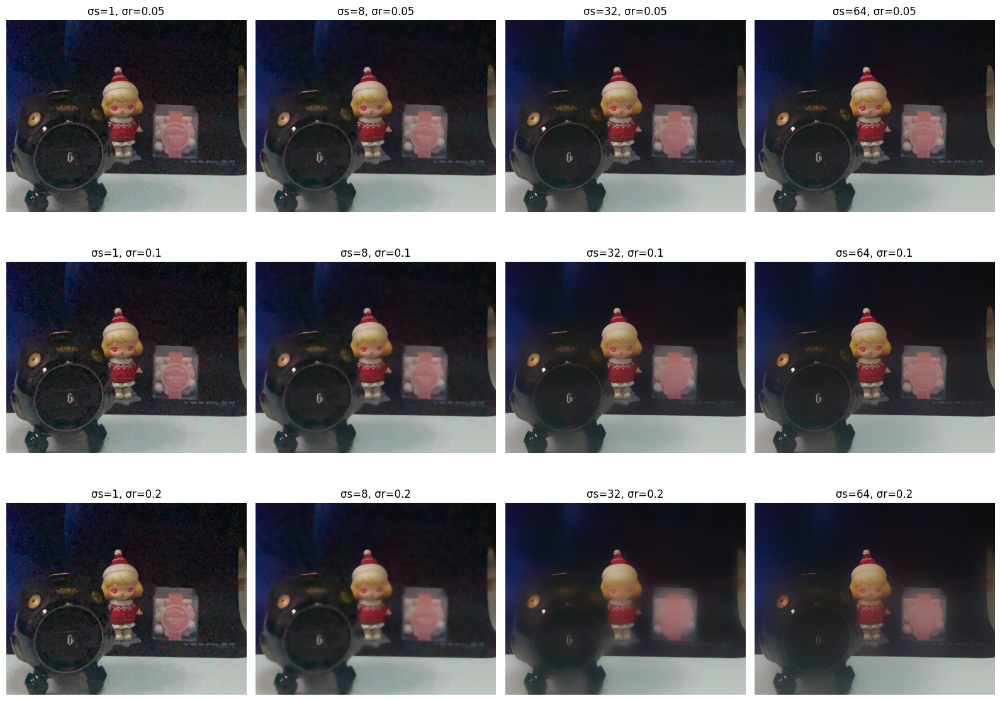

In [146]:
sigma_s_values = [1, 8, 32, 64]  
sigma_r_values = [0.05, 0.1, 0.2]  

fig, axes = plt.subplots(len(sigma_r_values), len(sigma_s_values), 
                        figsize=(16, 12))

for i, sigma_r in enumerate(sigma_r_values):
    for j, sigma_s in enumerate(sigma_s_values):
        filtered = piecewise_bilateral_filter(camera_nonflash_image, sigma_s, sigma_r)
        
        axes[i, j].imshow(filtered)
        axes[i, j].set_title(f'σs={sigma_s}, σr={sigma_r}')
        axes[i, j].axis('off')

plt.tight_layout()
plt.show()

To me, σs=32, σr=0.1 is good enough. Comparing with the others, it has a good balance of denoising to detail preservation. It still does not contain much of a detail but it is far better than the others. 

In [147]:
piecewise_bilateral_selected = piecewise_bilateral_filter(camera_nonflash_image, 32, 0.1)

### Joint-Bilateral Filtering

In [148]:
def joint_bilateral_filter(ambient_img, flash_img, sigma_s, sigma_r, nb_segments=None):
    """
    Function to apply joint bilateral filtering.
    
    :param ambient_img: Ambient (no-flash) image to be filtered
    :param flash_img: Flash image used for edge detection
    :param sigma_s: Standard deviation for the spatial Gaussian kernel
    :param sigma_r: Standard deviation for the range Gaussian kernel
    :param nb_segments: Number of segments for piecewise approximation
    
    :return Noise-reduced ambient image (A_NR):
    """
    
    if len(ambient_img.shape) == 3:
        result = np.zeros_like(ambient_img)
        
        # convert to luminance
        if len(flash_img.shape) == 3:
            flash_guide = np.mean(flash_img, axis=2)
        else:
            flash_guide = flash_img
            
        for c in range(ambient_img.shape[2]):
            result[:,:,c] = joint_bilateral_filter(
                ambient_img[:,:,c], 
                flash_guide, 
                sigma_s, 
                sigma_r, 
                nb_segments
            )
        return result
    
    lambda_val = 0.01
    min_val = np.min(flash_img) - lambda_val
    max_val = np.max(flash_img) + lambda_val
    
    if nb_segments is None:
        nb_segments = int(np.ceil((max_val - min_val) / sigma_r))
    
    segment_values = np.linspace(min_val, max_val, nb_segments)
    
    J_segments = np.zeros((ambient_img.shape[0], ambient_img.shape[1], nb_segments))
    
    for j, i_j in enumerate(segment_values):
        # g_r(Fp - Fp') in the paper's notation
        G_j = np.exp(-0.5 * ((flash_img - i_j) / sigma_r) ** 2)
        
        # K_j = G_j convolved with f_sigma_s
        K_j = cv2.GaussianBlur(G_j, (0, 0), sigma_s) + 1e-8
        
        # H_j = G_j * A (using ambient image for the actual values)
        H_j = G_j * ambient_img
        
        # H'_j = H_j convolved with f_sigma_s
        H_j_prime = cv2.GaussianBlur(H_j, (0, 0), sigma_s)
        
        # J_j = H'_j / K_j (normalized)
        J_j = H_j_prime / K_j
        
        # Store J_j in the multi-channel image
        J_segments[:, :, j] = J_j
    
    y_coords, x_coords = np.mgrid[0:flash_img.shape[0], 0:flash_img.shape[1]]
    
    xi = np.zeros((flash_img.shape[0] * flash_img.shape[1], 3))
    xi[:, 0] = y_coords.flatten()
    xi[:, 1] = x_coords.flatten()
    xi[:, 2] = flash_img.flatten()  # use flash values for interpolation indices
    
    output = interpolate.interpn(
        (np.arange(flash_img.shape[0]), np.arange(flash_img.shape[1]), segment_values),
        J_segments,
        xi,
        method='linear',
        bounds_error=False,
        fill_value=None
    )
    
    return output.reshape(ambient_img.shape)

### Experimenting

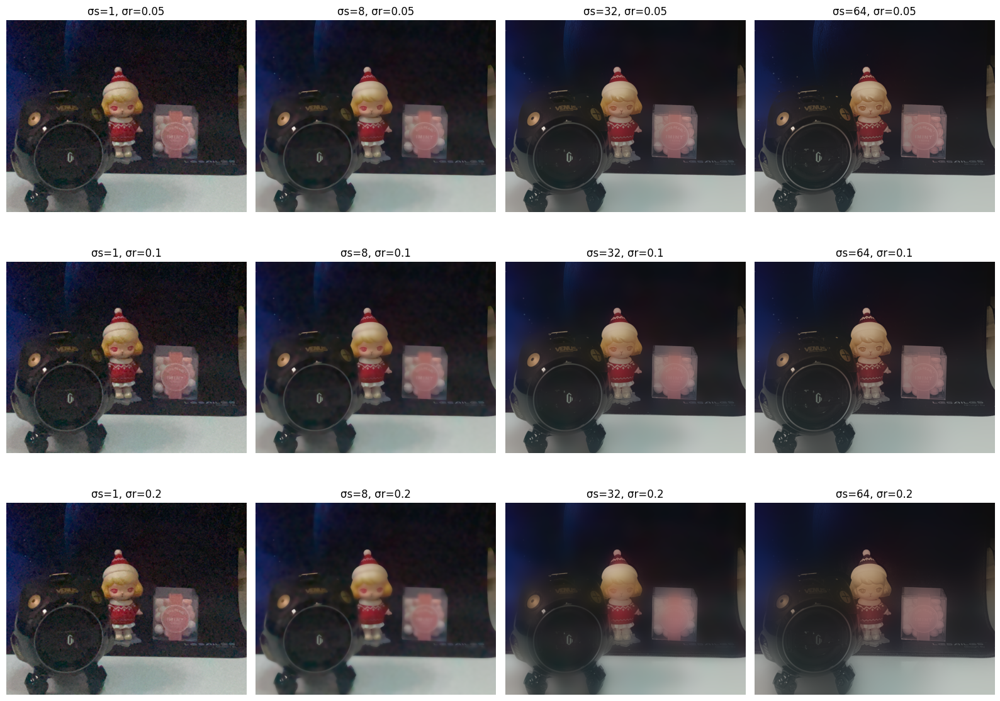

In [149]:
fig, axes = plt.subplots(len(sigma_r_values), len(sigma_s_values), 
                        figsize=(16, 12))

for i, sigma_r in enumerate(sigma_r_values):
    for j, sigma_s in enumerate(sigma_s_values):
        filtered = joint_bilateral_filter(camera_nonflash_image, camera_flash_image, sigma_s, sigma_r)
        
        axes[i, j].imshow(filtered)
        axes[i, j].set_title(f'σs={sigma_s}, σr={sigma_r}')
        axes[i, j].axis('off')

plt.tight_layout()
plt.show()

Among those parameters, σs=32, σr=0.1 is again the best performing one to me. Details are not that lost as we move downwards through the grid and it features a good amount of denoising as we inspect the grid row-wise. 

In [150]:
joint_bilateral_selected = joint_bilateral_filter(camera_nonflash_image, camera_flash_image, 32, 0.1)

### Detail Transfer

In [151]:
def detail_transfer(ambient_nr, flash_img, sigma_s, sigma_r, epsilon=0.02):
    """
    Implement flash-to-ambient detail transfer as described in Petschnigg et al.
    
    :param ambient_nr: Joint bilateral filtered ambient image (A_NR)
    :param flash_img: Flash image (F)
    :param sigma_s: Standard deviation for the spatial Gaussian kernel
    :param sigma_r: Standard deviation for the range/intensity Gaussian kernel
    :param epsilon: Small value to prevent division by zero and control detail transfer strength
    
    :return Detail-enhanced ambient image (A_Detail):
    """
    # to get F_Base
    flash_base = piecewise_bilateral_filter(flash_img, sigma_s, sigma_r)
    
    # A_Detail = A_NR * (F + ε) / (F_Base + ε)
    result = np.zeros_like(ambient_nr)
    for c in range(ambient_nr.shape[2]):
        result[:,:,c] = ambient_nr[:,:,c] * (flash_img[:,:,c] + epsilon) / (flash_base[:,:,c] + epsilon)
    return result

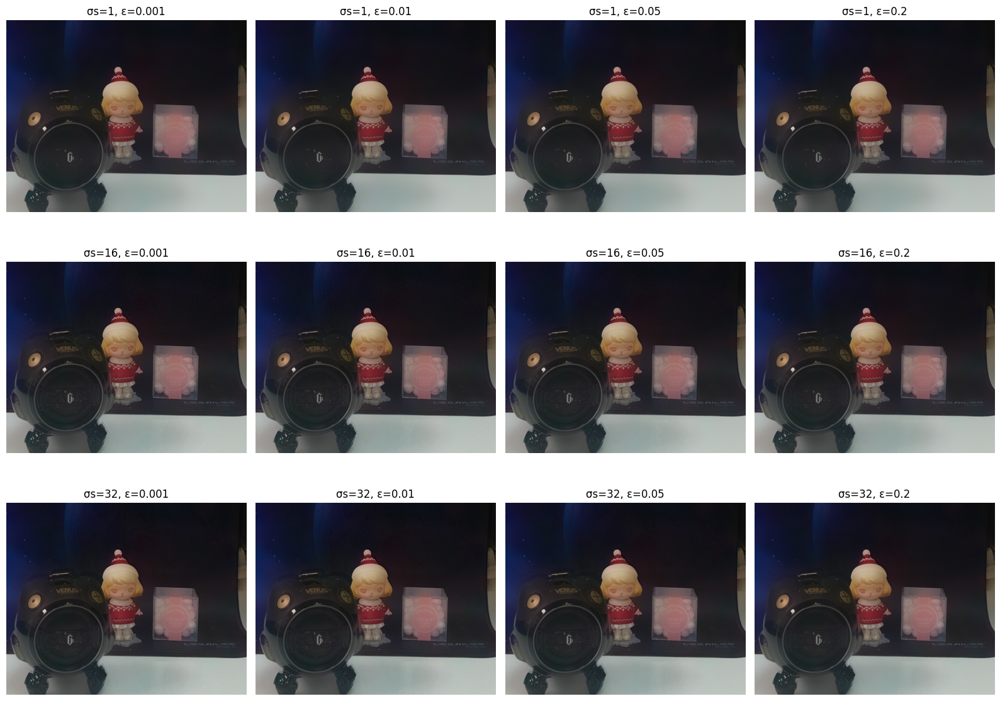

In [152]:
sigma_s_values = [1, 16, 32]  
epsilon_values = [0.001, 0.01, 0.05, 0.2]  

fig, axes = plt.subplots(len(sigma_s_values), len(epsilon_values), figsize=(16, 12))

for i, sigma_s in enumerate(sigma_s_values):
    for j, epsilon in enumerate(epsilon_values):
        filtered = detail_transfer(joint_bilateral_selected, camera_flash_image, 
                                  sigma_s, sigma_r_values[0], epsilon)
        
        axes[i, j].imshow(filtered)
        axes[i, j].set_title(f'σs={sigma_s}, ε={epsilon}')
        axes[i, j].axis('off')

plt.tight_layout()
plt.show()

They all look pretty similar actually. But they are visibly better than the non-detail transferred ones. If I'm to make a pick for this step too, I pick σs=32, ε=0.05. A greater epsilon value gives more strength to the detail transfer and σs=32 is just simply looks good and fits with the former experiment results.

Note: Range value is not included for the experiments for simplification purposes. Besides, I believe I've already found a good range parameter that I can use for this step too. So, it's not just for code simplification :)

In [153]:
detail_transfer_selected = detail_transfer(joint_bilateral_selected, camera_flash_image, 32, 0.1, 0.01)
detail_transfer_selected = np.clip(detail_transfer_selected, 0, 1)

### Shadow and Specularity Masking

In [154]:
def srgb_to_linear(image):
    """Convert from non-linear sRGB to linear RGB using the sRGB standard."""
    linear = np.zeros_like(image)
    
    mask = image <= 0.0404482
    linear[mask] = image[mask] / 12.92
    linear[~mask] = ((image[~mask] + 0.055) / 1.055) ** 2.4
    
    return linear

In [155]:
def create_shadow_specularity_mask(flash_img, ambient_img, shadow_threshold=-0.1, spec_percentile=0.95,
                                  shadow_sigma=3.0, spec_sigma=1.0):
    """
    Function to create mask for shadows and specularities as.
    
    :param flash_img: Flash image (F)
    :param ambient_img: Ambient image (A)
    :param shadow_threshold: Threshold τ for shadow detection (F_Lin - A_Lin ≤ τ)
    :param spec_percentile: Percentile of dynamic range for specularity detection (default: 0.95)
    :param shadow_sigma, spec_sigma: Smoothing parameters
    
    :return Combined mask (M):
    """
    flash_linear = srgb_to_linear(flash_img)
    ambient_linear = srgb_to_linear(ambient_img)
    
    # get luminance
    if len(flash_linear.shape) == 3:
        flash_lum = np.mean(flash_linear, axis=2)
        ambient_lum = np.mean(ambient_linear, axis=2)
    else:
        flash_lum = flash_linear
        ambient_lum = ambient_linear
    
    # shadow detection: F_Lin - A_Lin ≤ τ
    shadow_mask = (flash_lum - ambient_lum <= shadow_threshold).astype(np.float32)
    
    dynamic_range = np.max(flash_lum) - np.min(flash_lum)
    spec_threshold = np.min(flash_lum) + dynamic_range * spec_percentile
    specularity_mask = (flash_lum > spec_threshold).astype(np.float32)
    
    # smooth masks
    shadow_mask = cv2.GaussianBlur(shadow_mask, (0, 0), shadow_sigma)
    specularity_mask = cv2.GaussianBlur(specularity_mask, (0, 0), spec_sigma)
    
    # combine masks
    combined_mask = np.clip(shadow_mask + specularity_mask, 0, 1)
    
    if len(flash_img.shape) == 3:
        combined_mask = np.stack([combined_mask] * 3, axis=2)
    
    return combined_mask

In [156]:
def create_final_image(a_detail, a_base, flash_img, ambient_img, 
                      shadow_threshold=-0.1, spec_percentile=0.95, 
                      shadow_sigma=3.0, spec_sigma=1.0):
    """
    Function to create the final image by applying the shadow and specularity mask.
    
    :param a_detail: Detail-enhanced ambient image (A_Detail)
    :param a_base: Base ambient image from bilateral filtering (A_Base)
    :param flash_img: Flash image (F)
    :param ambient_img: Ambient image (A)
    :param shadow_threshold: Threshold τ for shadow detection (F_Lin - A_Lin ≤ τ)
    :param spec_percentile: Percentile of dynamic range for specularity detection (default: 0.95)
    :param shadow_sigma, spec_sigma: Smoothing parameters
    
    :return Final image (A_Final) and mask (M):
    """

    mask = create_shadow_specularity_mask(flash_img, ambient_img, 
                                         shadow_threshold, spec_percentile,
                                         shadow_sigma, spec_sigma)
    
    a_final = (1 - mask) * a_detail + mask * a_base
    
    return a_final, mask

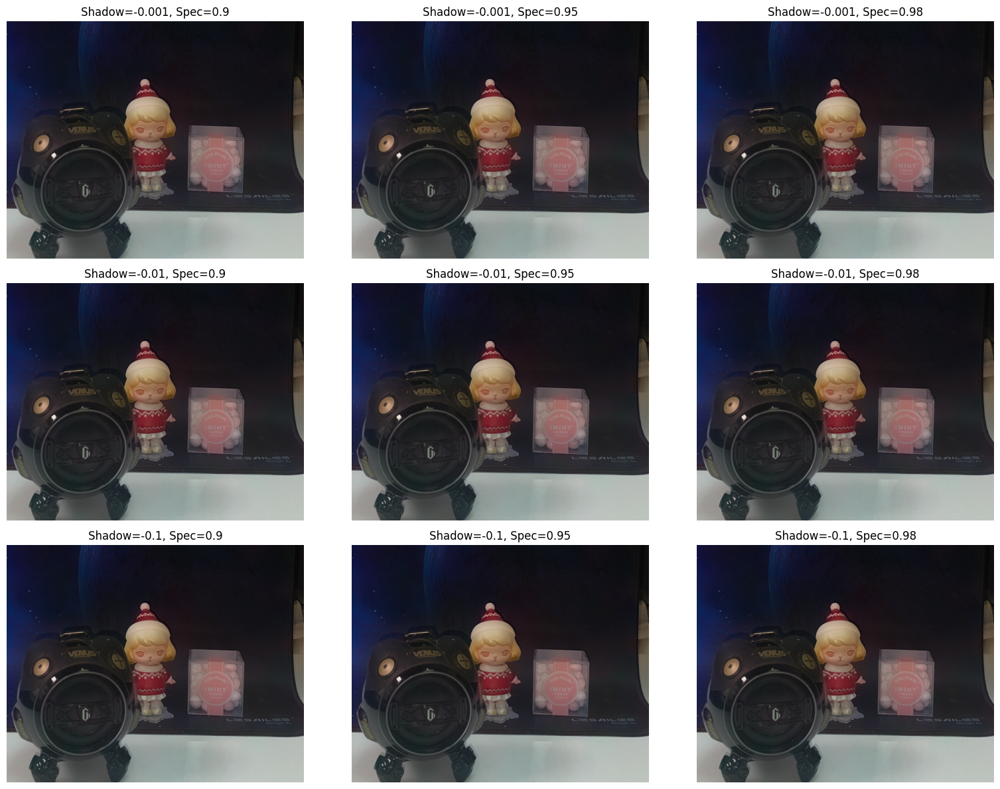

In [157]:
shadow_thresholds = [-0.001, -0.01, -0.1]  
specularity_thresholds = [0.90, 0.95, 0.98]  

fig, axes = plt.subplots(len(shadow_thresholds), len(specularity_thresholds), 
                         figsize=(16, 12))

for i, shadow_threshold in enumerate(shadow_thresholds):
    for j, spec_percentile in enumerate(specularity_thresholds):
        final_image, mask = create_final_image(
            detail_transfer_selected,       
            piecewise_bilateral_selected,   
            camera_flash_image, 
            camera_nonflash_image,
            shadow_threshold=shadow_threshold,
            spec_percentile=spec_percentile
        )
        
        axes[i, j].imshow(final_image)
        axes[i, j].set_title(f'Shadow={shadow_threshold}, Spec={spec_percentile}')
        axes[i, j].axis('off')

plt.tight_layout()
plt.show()

Well, there is again not much of a visible difference. This is probably caused by the fact that there wasn't much distinct shadows and specularities to begin with, in the flash image. This step does not add much visually. But again, to make a pick, I pick Shadow=-0.1, Spec=95.0. I mean, I already kinda know that there is zero-to-little shadow in the image, and Spec=95.0 just seems a good value, that is in between of the other 2.

In [158]:
masked_selected = create_final_image(
    detail_transfer_selected,       
    piecewise_bilateral_selected,   
    camera_flash_image, 
    camera_nonflash_image,
    shadow_threshold=-0.1,
    spec_percentile=95.0
)[0]

### Final Comparison

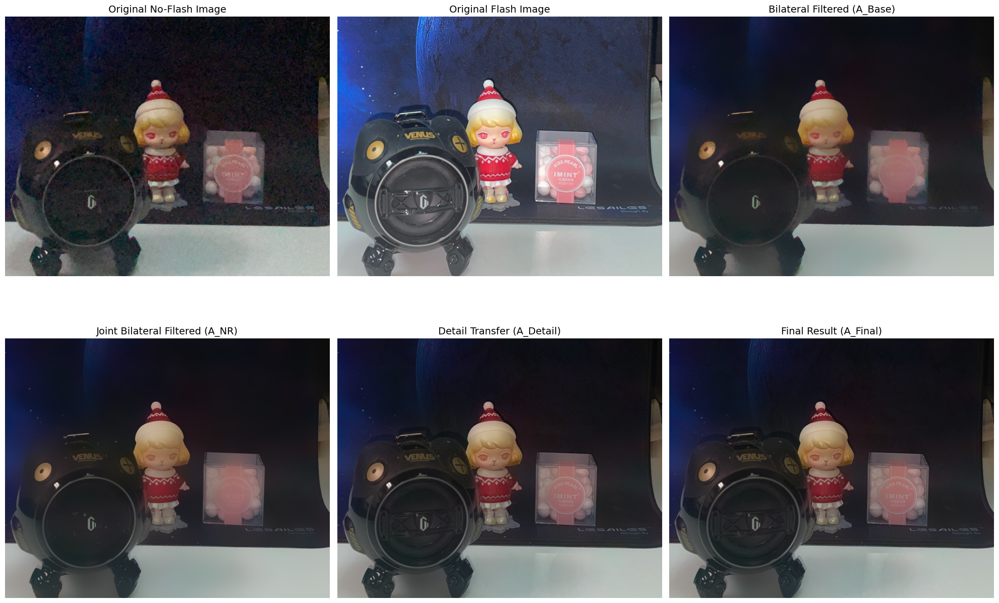

In [159]:
plt.figure(figsize=(20, 14))

plt.subplot(2, 3, 1)
plt.imshow(camera_nonflash_image)
plt.title('Original No-Flash Image', fontsize=14)
plt.axis('off')

plt.subplot(2, 3, 2)
plt.imshow(camera_flash_image)
plt.title('Original Flash Image', fontsize=14)
plt.axis('off')

plt.subplot(2, 3, 3)
plt.imshow(piecewise_bilateral_selected)
plt.title('Bilateral Filtered (A_Base)', fontsize=14)
plt.axis('off')

plt.subplot(2, 3, 4)
plt.imshow(joint_bilateral_selected)
plt.title('Joint Bilateral Filtered (A_NR)', fontsize=14)
plt.axis('off')

plt.subplot(2, 3, 5)
plt.imshow(detail_transfer_selected)
plt.title('Detail Transfer (A_Detail)', fontsize=14)
plt.axis('off')

plt.subplot(2, 3, 6)
plt.imshow(masked_selected)
plt.title('Final Result (A_Final)', fontsize=14)
plt.axis('off')

plt.tight_layout()
plt.show()

### Final Notes

Between these images, just the detail-transferred one looks the best. Previous ones are quite off from being the best, as expected, but the final result is surprisingly not that good too. I think this is the case because the scene is not that suitable for this scenario. Yes, the no flash image is incredibly noisy but the flash does not ruin the mood that much, when I inspect the flash image. It could use some post-editing, that's all. 

As much as I would like to capture some of that planet image on the mouse pad, it simply wasn't possible. I have tried really varying parameters but the outcome wasn't differing much, that is why I'm not including them to the final code. Tough luck!

---

## 2- Gradient-Domain Processing

In [160]:
def gradient(image):
    """Funtion to compute the gradient of an image."""

    if len(image.shape) == 3:
        grad_channels = []
        for c in range(image.shape[2]):
            grad_channels.append(gradient(image[..., c]))
        return grad_channels
    
    Ix = np.zeros_like(image)
    Ix[:, 1:] = np.diff(image, axis=1)  # forward difference in x-direction
    
    Iy = np.zeros_like(image)
    Iy[1:, :] = np.diff(image, axis=0)  # forward difference in y-direction
    
    return (Ix, Iy)

def divergence(gradient_field):
    """Funtion to compute the divergence of an image."""

    if isinstance(gradient_field, list):
        div_channels = []
        for channel_grad in gradient_field:
            div_channels.append(divergence(channel_grad))
        return np.stack(div_channels, axis=2)
    
    Fx, Fy = gradient_field
    
    # init divergence array
    div = np.zeros_like(Fx)
    
    # for internal pixels
    div_x = np.zeros_like(Fx)
    div_x[:, 1:] = np.diff(Fx, axis=1)  # this gives Fx[i,j] - Fx[i,j-1]
    
    # for boundary handling
    div_x[:, 0] = Fx[:, 0]              # left boundary
    div_x[:, -1] = -Fx[:, -2]           # right boundary
    
    # for internal pixels
    div_y = np.zeros_like(Fy)
    div_y[1:, :] = np.diff(Fy, axis=0)  # this gives Fy[i,j] - Fy[i-1,j]
    
    # for boundary handling
    div_y[0, :] = Fy[0, :]              # top boundary
    div_y[-1, :] = -Fy[-2, :]           # bottom boundary
    
    div = div_x + div_y
    
    return div

def laplacian(image):
    """Funtion to compute the laplacian of an image."""

    if len(image.shape) == 3:
        lap_channels = []
        for c in range(image.shape[2]):
            lap_channels.append(laplacian(image[..., c]))
        return np.stack(lap_channels, axis=2)
    
    kernel = np.array([[0, 1, 0], 
                      [1, -4, 1], 
                      [0, 1, 0]])
    
    # Apply convolution with the recommended parameters
    full_result = signal.convolve2d(image, kernel, mode='full', boundary='fill', fillvalue=0)
    
    # i needed to do this to get the right size for some reason
    # using mode='same' was enough but it is recommended to use 'full'
    h, w = image.shape
    k_h, k_w = kernel.shape
    start_h, start_w = k_h // 2, k_w // 2
    lap = full_result[start_h:start_h + h, start_w:start_w + w]
    
    return lap

In [161]:
def conjugate_gradient_descent(divergence, I_init, boundary_mask, I_boundary, 
                               epsilon=1e-6, max_iterations=1000):
    """
    Function to solve the Poisson equation using Conjugate Gradient Descent.
    
    :param divergence: Target divergence D
    :param I_init: Initial guess for the solution
    :param boundary_mask: Binary mask B (1 inside, 0 on boundary)
    :param I_boundary: Boundary values
    :param epsilon: Convergence parameter
    :param max_iterations: Maximum number of iterations
    
    :return Integrated image I*:
    """
    I_star = boundary_mask * I_init + (1 - boundary_mask) * I_boundary
    
    r = boundary_mask * (divergence - laplacian(I_star))
    d = r.copy()
    new_residual = np.sum(r * r)
    
    n = 0
    
    # CGD loop
    while np.sqrt(new_residual) > epsilon and n < max_iterations:
        # compute q = LaplacianFiltering(d)
        q = laplacian(d)
        
        # compute step size mu
        dq_product = np.sum(d * q)
        if dq_product == 0:  
            break
        mu = new_residual / dq_product
        
        # update solution
        I_star = I_star + boundary_mask * (mu * d)
        
        # update residual
        r = boundary_mask * (r - mu * q)
        
        # update residual norm
        old_residual = new_residual
        new_residual = np.sum(r * r)
        
        # update direction
        beta = new_residual / old_residual
        d = r + beta * d
        
        n += 1
        
        # Print progress every 100 iterations
        if n % 100 == 0:
            print(f"Iteration {n}, Residual: {np.sqrt(new_residual)}")
    
    print(f"CGD finished after {n} iterations with residual {np.sqrt(new_residual)}")
    return I_star

def experiment_integration(image, epsilon=1e-6, max_iterations=1000):
    """
    Function to run gradient field integration with customizable parameters
    
    :param image: Input image to differentiate and reintegrate
    :param epsilon: Convergence threshold for CGD
    :param max_iterations: Maximum number of CGD iterations
    
    :return Reintegrated image and time taken:
    """
    import time
    start_time = time.time() # put it for debugging purposes but it somehow made it to the final code
    
    if len(image.shape) == 3:
        result = np.zeros_like(image)
        for c in range(image.shape[2]):
            result[..., c] = experiment_integration(image[..., c], 
                                                   epsilon, 
                                                   max_iterations)[0]
        elapsed = time.time() - start_time
        return result, elapsed
    
    # compute gradient field
    grad = gradient(image)
    
    # compute divergence of gradient field
    div = divergence(grad)
    
    boundary_mask = np.ones_like(image)
    boundary_mask[0, :] = boundary_mask[-1, :] = 0
    boundary_mask[:, 0] = boundary_mask[:, -1] = 0
    
    I_boundary = image.copy()
    I_init = np.zeros_like(image)
    I_star = conjugate_gradient_descent(div, I_init, boundary_mask, I_boundary, 
                                       epsilon=epsilon, max_iterations=max_iterations)
    
    elapsed = time.time() - start_time
    return I_star, elapsed

Iteration 100, Residual: 0.8238414497970036
Iteration 200, Residual: 0.4396551780621517
Iteration 300, Residual: 0.2672425686249968
Iteration 400, Residual: 0.1815901723455163
Iteration 500, Residual: 0.1337579687624363
CGD finished after 500 iterations with residual 0.1337579687624363
Iteration 100, Residual: 0.6670456661338964
Iteration 200, Residual: 0.33822470793310055
Iteration 300, Residual: 0.21879980997396611
Iteration 400, Residual: 0.14956080924605264
Iteration 500, Residual: 0.11179921012070546
CGD finished after 500 iterations with residual 0.11179921012070546
Iteration 100, Residual: 0.44098871681698576
Iteration 200, Residual: 0.2083657717074278
Iteration 300, Residual: 0.12766410699191125
Iteration 400, Residual: 0.08673694303519575


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7155814..0.972549].


Iteration 500, Residual: 0.0661134272522634
CGD finished after 500 iterations with residual 0.0661134272522634
Iteration 100, Residual: 0.8238414497970036
Iteration 200, Residual: 0.4396551780621517
Iteration 300, Residual: 0.2672425686249968
Iteration 400, Residual: 0.1815901723455163
Iteration 500, Residual: 0.1337579687624363
Iteration 600, Residual: 0.1217701807431668
Iteration 700, Residual: 0.11398964893794251
Iteration 800, Residual: 0.10267019550298241
Iteration 900, Residual: 0.09756199699928605
Iteration 1000, Residual: 0.08342230572280833
CGD finished after 1000 iterations with residual 0.08342230572280833
Iteration 100, Residual: 0.6670456661338964
Iteration 200, Residual: 0.33822470793310055
Iteration 300, Residual: 0.21879980997396611
Iteration 400, Residual: 0.14956080924605264
Iteration 500, Residual: 0.11179921012070546
Iteration 600, Residual: 0.09476602029647375
Iteration 700, Residual: 0.08039461490549135
Iteration 800, Residual: 0.07087963737699166
Iteration 900, R

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.44020584..0.99027973].


Iteration 1000, Residual: 0.04224218083576951
CGD finished after 1000 iterations with residual 0.04224218083576951
Iteration 100, Residual: 0.8238414497970036
Iteration 200, Residual: 0.4396551780621517
Iteration 300, Residual: 0.2672425686249968
Iteration 400, Residual: 0.1815901723455163
Iteration 500, Residual: 0.1337579687624363
Iteration 600, Residual: 0.1217701807431668
Iteration 700, Residual: 0.11398964893794251
Iteration 800, Residual: 0.10267019550298241
Iteration 900, Residual: 0.09756199699928605
Iteration 1000, Residual: 0.08342230572280833
Iteration 1100, Residual: 0.0747072227788458
Iteration 1200, Residual: 0.07140689928439689
Iteration 1300, Residual: 0.06755650700394804
Iteration 1400, Residual: 0.061034645817178684
Iteration 1500, Residual: 0.06660984062627585
Iteration 1600, Residual: 0.054157717624000755
Iteration 1700, Residual: 0.04157016823984871
Iteration 1800, Residual: 0.031787024789874115
Iteration 1900, Residual: 0.02280549764770834
Iteration 2000, Residual

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07116927..1.0933613].


Iteration 2000, Residual: 0.009082765025878212
CGD finished after 2000 iterations with residual 0.009082765025878212


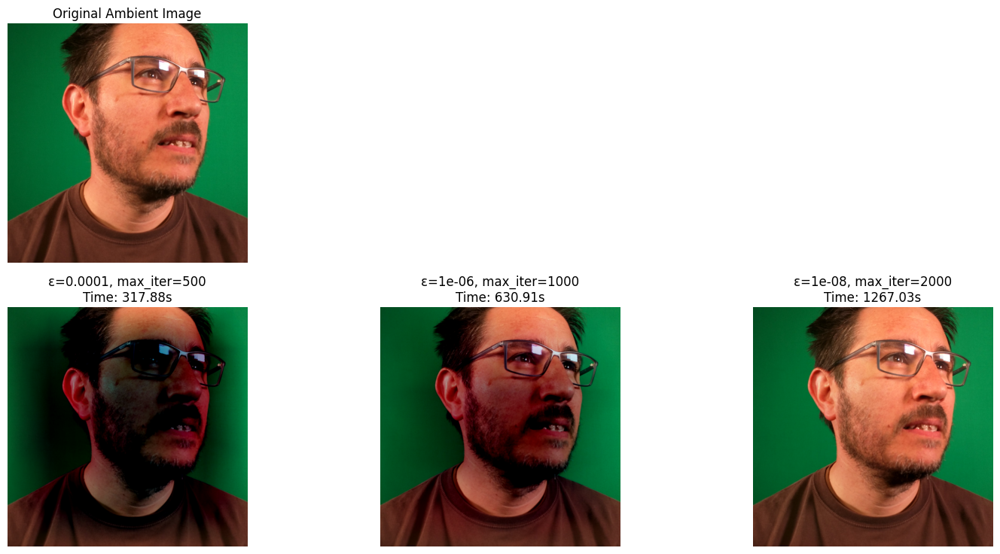

In [162]:
params = [
    (1e-4, 500), 
    (1e-6, 1000),
    (1e-8, 2000) 
]

plt.figure(figsize=(15, 5*len(params)))

plt.subplot(len(params)+1, 3, 1)
plt.imshow(face_nonflash_image)
plt.title('Original Ambient Image')
plt.axis('off')

for i, (eps, max_iter) in enumerate(params):
    result, time_taken = experiment_integration(face_nonflash_image, epsilon=eps, max_iterations=max_iter)
    
    plt.subplot(len(params)+1, 3, i+4)
    plt.imshow(result)
    plt.title(f'ε={eps}, max_iter={max_iter}\nTime: {time_taken:.2f}s')
    plt.axis('off')

plt.tight_layout()
plt.show()

This "experiment" was done for testing purposes. We can clearly see that the code works and gets closer and closer to the original image.

In [163]:
def compute_coherency_map(flash_img, ambient_img):
    """
    Function to compute the gradient orientation coherency map M.
    
    Parameters:
    :param flash_img: Flash image
    :param ambient_img: Ambient image
    
    :return M: Coherency map:
    """

    grad_flash = gradient(flash_img)
    grad_ambient = gradient(ambient_img)
    
    if isinstance(grad_flash, list):
        M_channels = []
        for c in range(len(grad_flash)):
            M_channels.append(compute_coherency_map_single_channel(grad_flash[c], grad_ambient[c]))
        M = np.mean(np.stack(M_channels, axis=2), axis=2)
        return M, grad_flash, grad_ambient
    
    return compute_coherency_map_single_channel(grad_flash, grad_ambient), grad_flash, grad_ambient

def compute_coherency_map_single_channel(grad_flash, grad_ambient):
    """Compute coherency map for a single channel."""

    flash_x, flash_y = grad_flash
    ambient_x, ambient_y = grad_ambient
    
    dot_product = flash_x * ambient_x + flash_y * ambient_y
    
    flash_mag = np.sqrt(flash_x**2 + flash_y**2 + 1e-10)  
    ambient_mag = np.sqrt(ambient_x**2 + ambient_y**2 + 1e-10)
    
    M = np.abs(dot_product) / (flash_mag * ambient_mag)
    
    return M

In [164]:
def compute_saturation_weight(flash_img, sigma=10, tau_s=0.1):
    """
    Function to compute the pixel-wise saturation weight map ws.
    
    Parameters:
    :param flash_img: Flash image
    :param sigma: Scaling factor for the tanh function
    :param tau_s: Threshold for saturation
    
    :return ws: Saturation weight map normalized to [0, 1]
    """

    if len(flash_img.shape) == 3:
        flash_luminance = np.mean(flash_img, axis=2)
    else:
        flash_luminance = flash_img
    
    ws = np.tanh(sigma * (flash_luminance - tau_s))
    
    # [0, 1]
    ws = (ws - np.min(ws)) / (np.max(ws) - np.min(ws) + 1e-10)
    
    if len(flash_img.shape) == 3:
        ws = np.stack([ws] * flash_img.shape[2], axis=2)
    
    return ws

In [165]:
def compute_fused_gradient(grad_ambient, grad_flash, M, ws):
    """
    Function to compute the fused gradient field.
    
    :param grad_ambient: Gradient field of ambient image
    :param grad_flash: Gradient field of flash image
    :param M: Coherency map
    :param ws: Saturation weight map
    
    :return grad_fused: Fused gradient field
    """

    if isinstance(grad_ambient, list):
        grad_fused = []
        for c in range(len(grad_ambient)):
            ws_channel = ws[:,:,c] if len(ws.shape) == 3 else ws
            
            M_channel = M if len(M.shape) == 2 else M[:,:,c]
            
            fused_x, fused_y = compute_fused_gradient_single_channel(
                grad_ambient[c], grad_flash[c], M_channel, ws_channel
            )
            grad_fused.append((fused_x, fused_y))
        return grad_fused
    
    return compute_fused_gradient_single_channel(grad_ambient, grad_flash, M, ws)

def compute_fused_gradient_single_channel(grad_ambient, grad_flash, M, ws):
    """Compute fused gradient field for a single channel."""
    ambient_x, ambient_y = grad_ambient
    flash_x, flash_y = grad_flash
    
    if len(ws.shape) == 3:
        ws = ws[:,:,0]  
    
    if len(M.shape) == 3:
        M = M[:,:,0]  
    
    # x component
    fused_x = ws * ambient_x + (1 - ws) * (M * flash_x + (1 - M) * ambient_x)
    
    # y component
    fused_y = ws * ambient_y + (1 - ws) * (M * flash_y + (1 - M) * ambient_y)
    
    return (fused_x, fused_y)

In [166]:
def integrate_fused_gradient(grad_fused, ambient_img, flash_img, boundary_type='ambient', init_type='zero', epsilon=1e-6, max_iterations=1000):
    """
    Function to integrate the fused gradient field to obtain the final fused image.
    
    Parameters:
    :param grad_fused: Fused gradient field 
    :param ambient_img: Ambient imag
    :param flash_img: Flash image
    :param boundary_type: Type of boundary condition ('ambient', 'flash', or 'average')
    :param init_type: Initialization type ('zero', 'ambient', 'flash', or 'average')
    :param epsilon: Convergence threshold for CGD
    :param max_iterations: Maximum number of CGD iterations
    
    :return fused_img: Final fused image
    """

    if isinstance(grad_fused, list):
        fused_img = np.zeros_like(ambient_img)
        for c in range(ambient_img.shape[2]):
            fused_img[:,:,c] = integrate_fused_gradient_single_channel(
                grad_fused[c],
                ambient_img[:,:,c],
                flash_img[:,:,c],
                boundary_type, 
                init_type,
                epsilon,
                max_iterations
            )
        return fused_img
    
    return integrate_fused_gradient_single_channel(
        grad_fused, ambient_img, flash_img, boundary_type, init_type, epsilon, max_iterations
    )

def integrate_fused_gradient_single_channel(grad_fused, ambient, flash, boundary_type, init_type, epsilon, max_iterations):
    """
    Integrate the fused gradient field for a single channel.
    """
    div_fused = divergence(grad_fused)
    
    boundary_mask = np.ones_like(ambient)
    boundary_mask[0,:] = boundary_mask[-1,:] = 0
    boundary_mask[:,0] = boundary_mask[:,-1] = 0
    
    if boundary_type == 'ambient':
        I_boundary = ambient.copy()
    elif boundary_type == 'flash':
        I_boundary = flash.copy()
    elif boundary_type == 'average':
        I_boundary = 0.5 * (ambient + flash)
    
    if init_type == 'zero':
        I_init = np.zeros_like(ambient)
    elif init_type == 'ambient':
        I_init = ambient.copy()
    elif init_type == 'flash':
        I_init = flash.copy()
    elif init_type == 'average':
        I_init = 0.5 * (ambient + flash)
    
    fused = conjugate_gradient_descent(
        div_fused, I_init, boundary_mask, I_boundary, epsilon, max_iterations
    )
    
    return fused

In [167]:
def create_fused_image(ambient_img, flash_img, sigma=10, tau_s=0.1, boundary_type='ambient', 
                      init_type='zero', epsilon=1e-6, max_iterations=1000):
    """
    Create a fused image from flash and no-flash image pair using gradient domain fusion.
    
    :param ambient_img: Ambient (no-flash) image
    :param flash_img: Flash image
    :param sigma: Scaling factor for saturation weight
    :param tau_s: Threshold for saturation
    :param boundary_type: Type of boundary condition
    :param init_type: Initialization type
    :param epsilon: Convergence threshold for CGD
    :param max_iterations: Maximum number of CGD iterations
    
    :return fused_img: Final fused image
    """

    import time
    start_time = time.time()
    
    M, grad_flash, grad_ambient = compute_coherency_map(flash_img, ambient_img)
    ws = compute_saturation_weight(flash_img, sigma, tau_s)
    grad_fused = compute_fused_gradient(grad_ambient, grad_flash, M, ws)
    
    fused_img = integrate_fused_gradient(
        grad_fused, ambient_img, flash_img, 
        boundary_type, init_type, epsilon, max_iterations
    )
    
    elapsed = time.time() - start_time
    print(f"Fusion completed in {elapsed:.2f} seconds")
    
    return fused_img

def visualize_gradient_fusion_results(ambient_img, flash_img, fused_img):
    """Visualize the results of gradient domain fusion."""
    plt.figure(figsize=(15, 5))
    
    plt.subplot(1, 3, 1)
    plt.imshow(ambient_img)
    plt.title('Ambient Image')
    plt.axis('off')
    
    plt.subplot(1, 3, 2)
    plt.imshow(flash_img)
    plt.title('Flash Image')
    plt.axis('off')
    
    plt.subplot(1, 3, 3)
    plt.imshow(fused_img)
    plt.title('Fused Image')
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()

Iteration 100, Residual: 0.16654921595157268
Iteration 200, Residual: 0.07912032889305454
Iteration 300, Residual: 0.04738842730847668
Iteration 400, Residual: 0.03405587675541863
Iteration 500, Residual: 0.025759804367634243
Iteration 600, Residual: 0.02096374875244421
Iteration 700, Residual: 0.01776653333313507
Iteration 800, Residual: 0.015274572350588794
Iteration 900, Residual: 0.012487167619932417
Iteration 1000, Residual: 0.010623876697703146
Iteration 1100, Residual: 0.009302761578828287
Iteration 1200, Residual: 0.008287160700596369
Iteration 1300, Residual: 0.007430076976516111
Iteration 1400, Residual: 0.007304575617939312
Iteration 1500, Residual: 0.00652696987940844
Iteration 1600, Residual: 0.005803503670329113
Iteration 1700, Residual: 0.00512148853163879
Iteration 1800, Residual: 0.004352306602292221
Iteration 1900, Residual: 0.0037355888980300377
Iteration 2000, Residual: 0.0033818364178966123
CGD finished after 2000 iterations with residual 0.0033818364178966123
Iter

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.17770088..1.052509].


Iteration 2000, Residual: 0.0036191615849654993
CGD finished after 2000 iterations with residual 0.0036191615849654993
Fusion completed in 1277.67 seconds


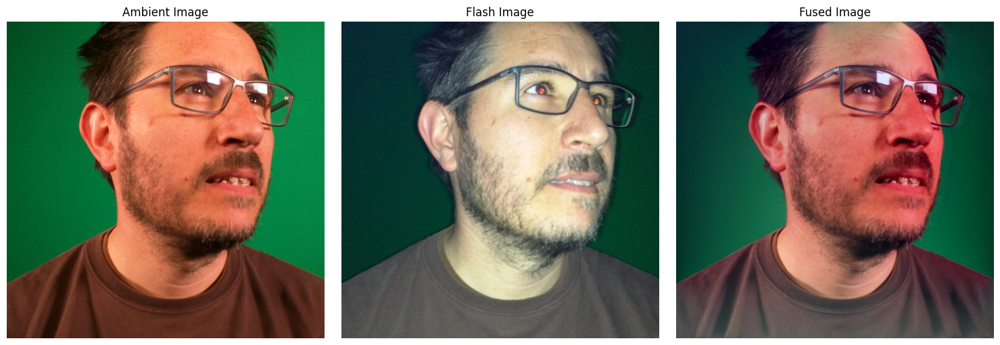

In [168]:
sigma = 10       
tau_s = 0.1      

fused_img_exp1 = create_fused_image(
    face_nonflash_image,
    face_flash_image,
    sigma=sigma, 
    tau_s=tau_s,
    boundary_type='flash',    
    init_type='ambient',      
    epsilon=1e-8, 
    max_iterations=2000
)

visualize_gradient_fusion_results(face_nonflash_image, face_flash_image, fused_img_exp1)

Iteration 100, Residual: 0.2783413497096461
Iteration 200, Residual: 0.10101560731621383
Iteration 300, Residual: 0.05191485356746447
Iteration 400, Residual: 0.03320941009188191
Iteration 500, Residual: 0.023494594168870578
Iteration 600, Residual: 0.018089141816044867
Iteration 700, Residual: 0.015503687969357426
Iteration 800, Residual: 0.013188499941506735
Iteration 900, Residual: 0.010762410806546715
Iteration 1000, Residual: 0.009335338352249803
Iteration 1100, Residual: 0.007301459872892801
Iteration 1200, Residual: 0.006412380309583916
Iteration 1300, Residual: 0.006063697435877821
Iteration 1400, Residual: 0.005268767704140456
Iteration 1500, Residual: 0.0043276636992729154
Iteration 1600, Residual: 0.0036110344287851055
Iteration 1700, Residual: 0.0029811152436781557
Iteration 1800, Residual: 0.0024654101729240565
Iteration 1900, Residual: 0.0025256385049800653
Iteration 2000, Residual: 0.0021823088358939153
CGD finished after 2000 iterations with residual 0.00218230883589391

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.09641292..1.0550061].


Iteration 2000, Residual: 0.0044124732258119855
CGD finished after 2000 iterations with residual 0.0044124732258119855
Fusion completed in 1279.51 seconds


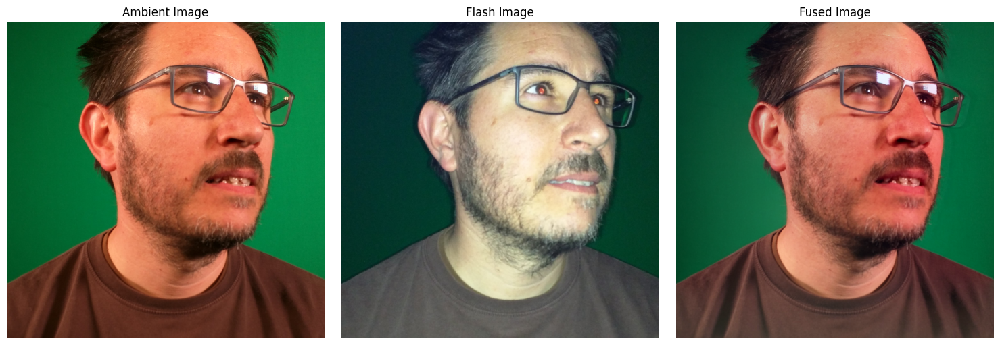

In [169]:
fused_img_exp2 = create_fused_image(
    face_nonflash_image,
    face_flash_image,
    sigma=sigma, 
    tau_s=tau_s,
    boundary_type='average',  
    init_type='average',      
    epsilon=1e-8, 
    max_iterations=2000
)

visualize_gradient_fusion_results(face_nonflash_image, face_flash_image, fused_img_exp2)

Iteration 100, Residual: 0.5670125548920504
Iteration 200, Residual: 0.2016906578308662
Iteration 300, Residual: 0.10392583300648399
Iteration 400, Residual: 0.06671917978701145
Iteration 500, Residual: 0.04636538682826591
Iteration 600, Residual: 0.0348197644760471
Iteration 700, Residual: 0.028617129202889238
Iteration 800, Residual: 0.0236854099514298
Iteration 900, Residual: 0.0188173416636314
Iteration 1000, Residual: 0.01659950613784331
Iteration 1100, Residual: 0.013466769901273204
Iteration 1200, Residual: 0.012212782546042874
Iteration 1300, Residual: 0.011743520777313011
Iteration 1400, Residual: 0.00960427290261116
Iteration 1500, Residual: 0.007404728617283987
Iteration 1600, Residual: 0.005576021857086832
Iteration 1700, Residual: 0.004033264079314153
Iteration 1800, Residual: 0.0031951013868706923
Iteration 1900, Residual: 0.003337360353511567
Iteration 2000, Residual: 0.0029766683561899135
CGD finished after 2000 iterations with residual 0.0029766683561899135
Iteration 1

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.19209482..1.0694735].


Iteration 2000, Residual: 0.008935107079593343
CGD finished after 2000 iterations with residual 0.008935107079593343
Fusion completed in 1280.52 seconds


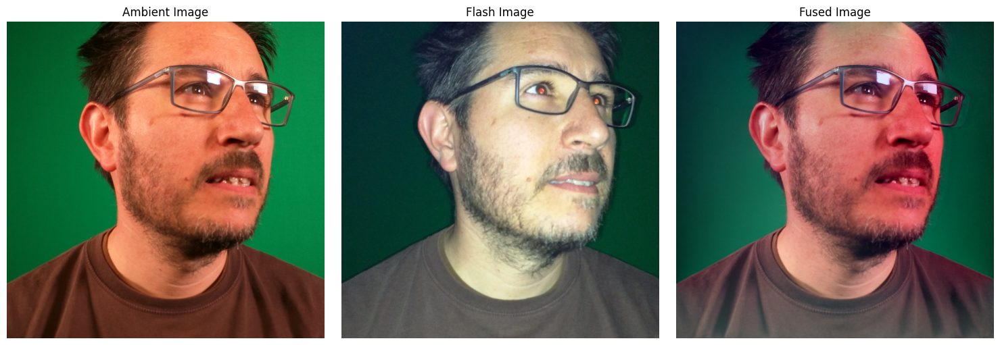

In [170]:
fused_img_exp3 = create_fused_image(
    face_nonflash_image,
    face_flash_image,
    sigma=sigma, 
    tau_s=tau_s,
    boundary_type='flash',    
    init_type='flash',        
    epsilon=1e-8, 
    max_iterations=2000
)

visualize_gradient_fusion_results(face_nonflash_image, face_flash_image, fused_img_exp3)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.17770088..1.052509].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.09641292..1.0550061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.19209482..1.0694735].


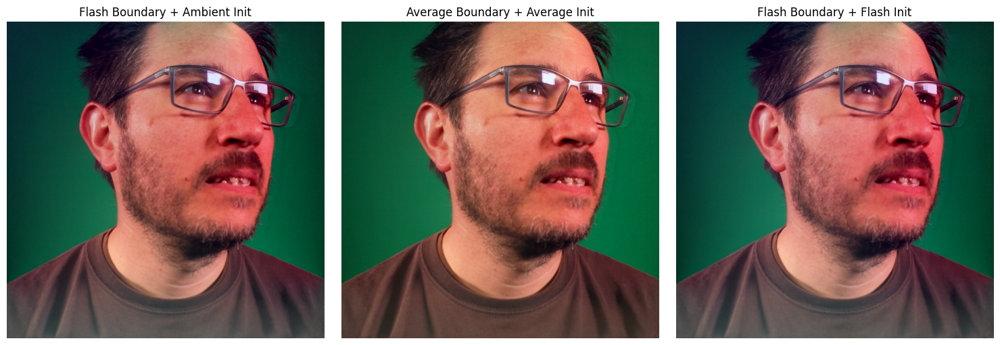

In [171]:
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.imshow(fused_img_exp1)
plt.title('Flash Boundary + Ambient Init')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(fused_img_exp2)
plt.title('Average Boundary + Average Init')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(fused_img_exp3)
plt.title('Flash Boundary + Flash Init')
plt.axis('off')

plt.tight_layout()
plt.show()

They are all quite good but the second one really stands out. It is the one with the least negative vignette and red face. The colors are better overall. This shows that the average selection as boundary and init types is quite good, which is intuitive. 

---

## 3- My Images

### Disclaimer: I know my images are quite far from ideal. That was the best I could do in my dorm environment. And I had quite a little time for this assignment, my aim was to not using any slip days actually, but this probably will not be possible.

In [185]:
def resize_image(img, max_dim=800):
    """Resize image while maintaining aspect ratio"""
    h, w = img.shape[:2]
    if max(h, w) > max_dim:
        scale = max_dim / max(h, w)
        new_h, new_w = int(h * scale), int(w * scale)
        return cv2.resize(img, (new_w, new_h), interpolation=cv2.INTER_AREA)
    return img

my_nonflash_image1 = cv2.imread(os.path.join(os.getcwd(), 'data', '1_1.jpg'))
my_nonflash_image1 = cv2.cvtColor(my_nonflash_image1, cv2.COLOR_BGR2RGB)
my_nonflash_image1 = resize_image(my_nonflash_image1)
my_nonflash_image1 = my_nonflash_image1.astype(np.float32) / 255.0

my_flash_image1 = cv2.imread(os.path.join(os.getcwd(), 'data', '1_2.jpg'))
my_flash_image1 = cv2.cvtColor(my_flash_image1, cv2.COLOR_BGR2RGB)
my_flash_image1 = resize_image(my_flash_image1)
my_flash_image1 = my_flash_image1.astype(np.float32) / 255.0

my_nonflash_image2 = cv2.imread(os.path.join(os.getcwd(), 'data', '2_1.jpg'))
my_nonflash_image2 = cv2.cvtColor(my_nonflash_image2, cv2.COLOR_BGR2RGB)
my_nonflash_image2 = resize_image(my_nonflash_image2)
my_nonflash_image2 = my_nonflash_image2.astype(np.float32) / 255.0

my_flash_image2 = cv2.imread(os.path.join(os.getcwd(), 'data', '2_2.jpg'))
my_flash_image2 = cv2.cvtColor(my_flash_image2, cv2.COLOR_BGR2RGB)
my_flash_image2 = resize_image(my_flash_image2)
my_flash_image2 = my_flash_image2.astype(np.float32) / 255.0

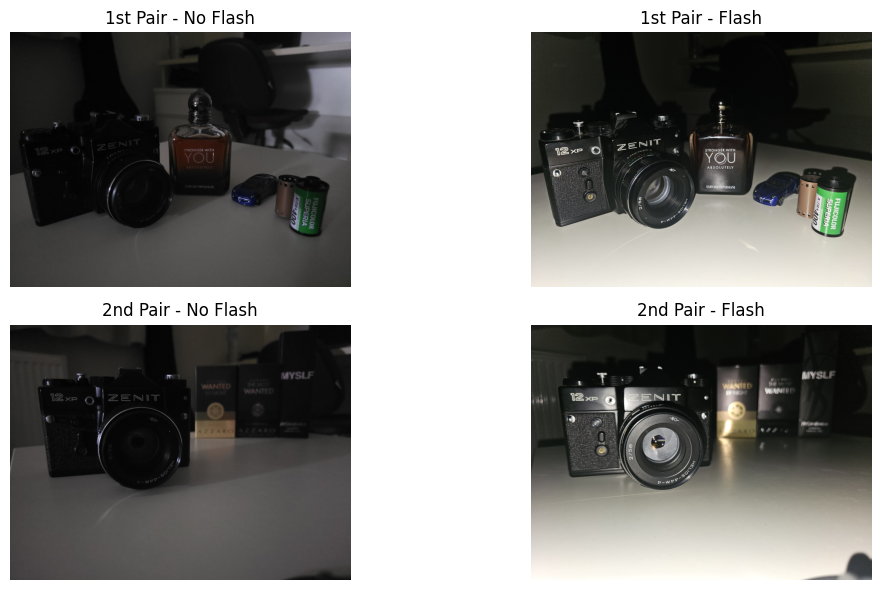

In [186]:
plt.figure(figsize=(12, 6))
plt.subplot(2, 2, 1)
plt.imshow(my_nonflash_image1)
plt.title('1st Pair - No Flash')
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(my_flash_image1)
plt.title('1st Pair - Flash')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(my_nonflash_image2)
plt.title('2nd Pair - No Flash')
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(my_flash_image2)
plt.title('2nd Pair - Flash')
plt.axis('off')

plt.tight_layout()
plt.show()

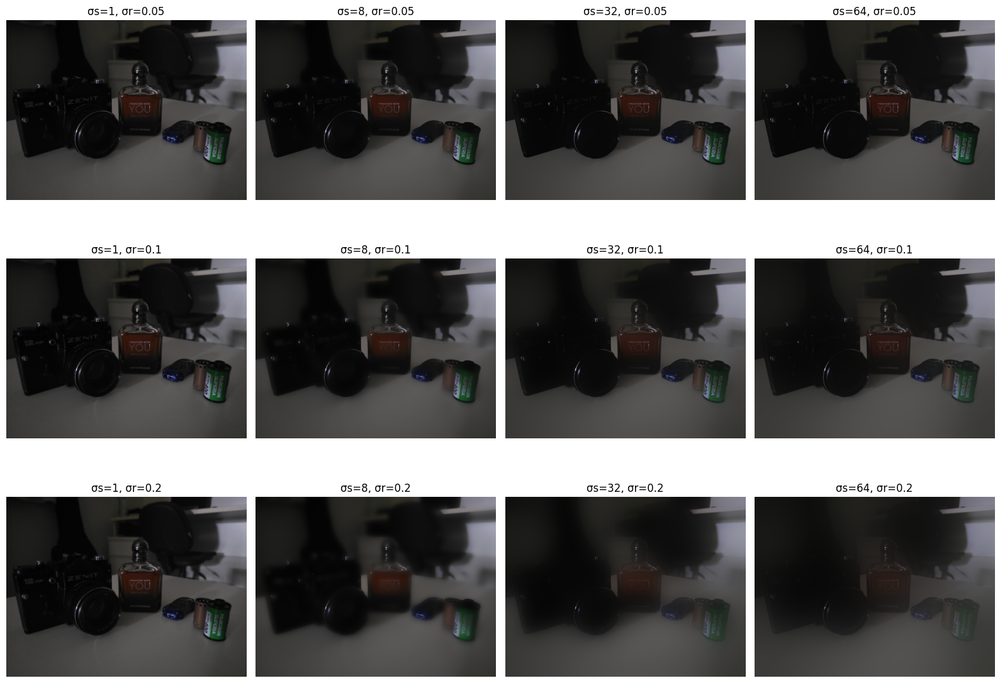

In [187]:
# same parameters as used before
sigma_s_values = [1, 8, 32, 64]  
sigma_r_values = [0.05, 0.1, 0.2]

fig, axes = plt.subplots(len(sigma_r_values), len(sigma_s_values), 
                        figsize=(16, 12))

for i, sigma_r in enumerate(sigma_r_values):
    for j, sigma_s in enumerate(sigma_s_values):
        filtered = piecewise_bilateral_filter(my_nonflash_image1, sigma_s, sigma_r)
        
        axes[i, j].imshow(filtered)
        axes[i, j].set_title(f'σs={sigma_s}, σr={sigma_r}')
        axes[i, j].axis('off')

plt.tight_layout()
plt.show()

To be honest they are all rubbish :) but the bottom left corner is the best among them, in my opinion.

In [188]:
my_piecewise_bilateral = piecewise_bilateral_filter(my_nonflash_image1, 1, 0.2)

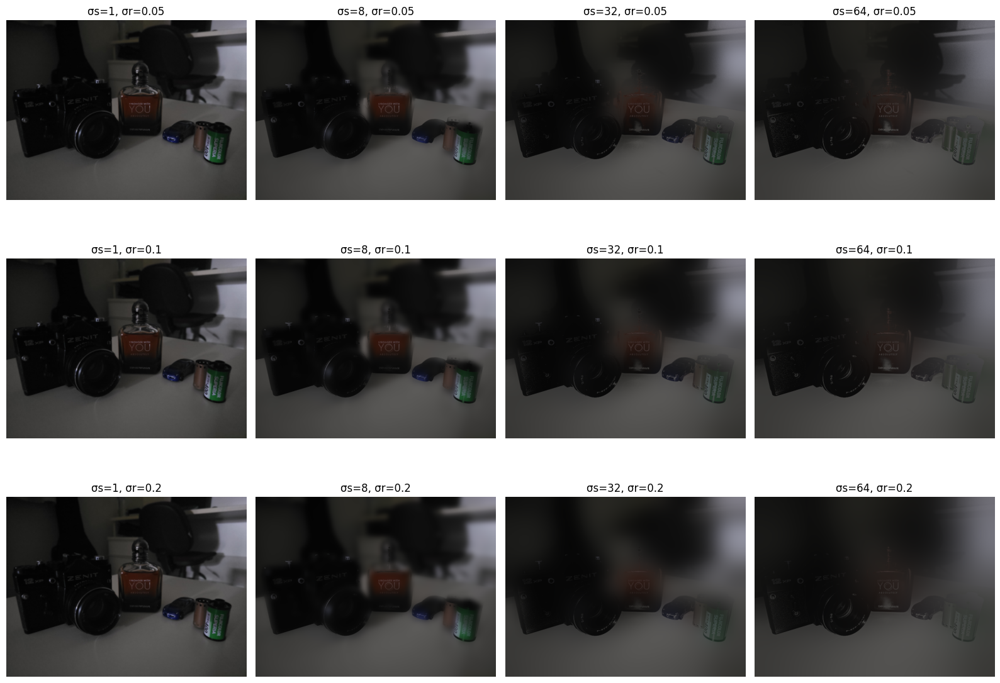

In [189]:
fig, axes = plt.subplots(len(sigma_r_values), len(sigma_s_values), 
                        figsize=(16, 12))

for i, sigma_r in enumerate(sigma_r_values):
    for j, sigma_s in enumerate(sigma_s_values):
        filtered = joint_bilateral_filter(my_nonflash_image1, my_flash_image1, sigma_s, sigma_r)
        
        axes[i, j].imshow(filtered)
        axes[i, j].set_title(f'σs={sigma_s}, σr={sigma_r}')
        axes[i, j].axis('off')

plt.tight_layout()
plt.show()

My selection of parameters stays the same for joint bilateral filtering.

In [190]:
my_joint_bilateral = joint_bilateral_filter(my_nonflash_image1, my_flash_image1, 1, 0.2)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0018798612..1.3343923].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0038326143..1.2983443].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0063871793..1.1848695].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.008469316..1.0136149].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0010362697..2.2854497].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0019703784..2.1175618].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range

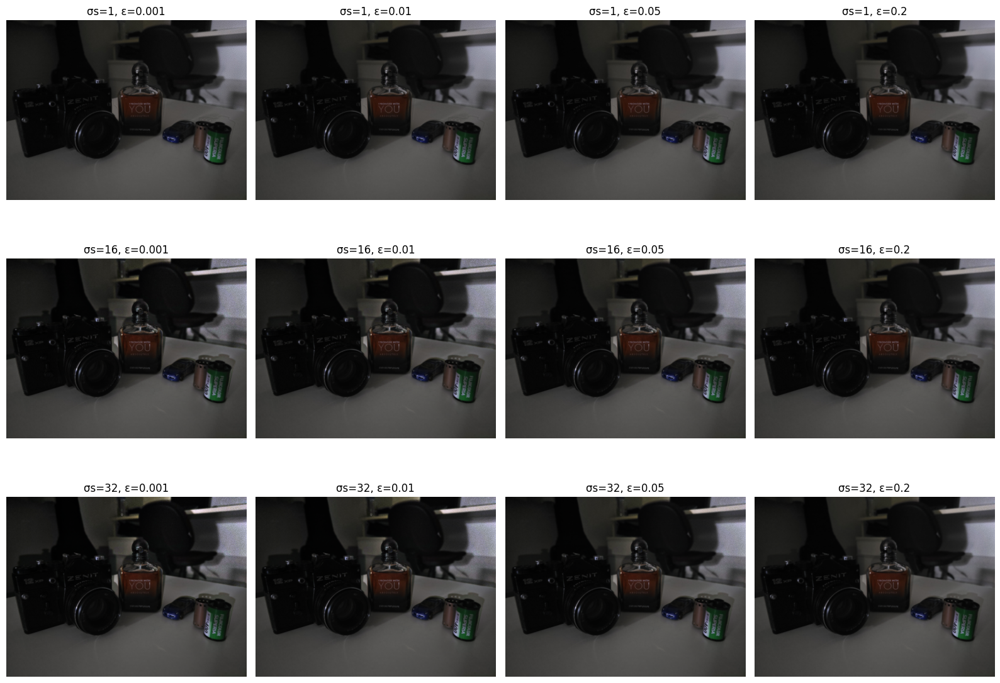

In [191]:
sigma_s_values = [1, 16, 32]  
epsilon_values = [0.001, 0.01, 0.05, 0.2]

fig, axes = plt.subplots(len(sigma_s_values), len(epsilon_values), figsize=(16, 12))

for i, sigma_s in enumerate(sigma_s_values):
    for j, epsilon in enumerate(epsilon_values):
        filtered = detail_transfer(my_joint_bilateral, my_flash_image1, 
                                  sigma_s, 0.1, epsilon)
        
        axes[i, j].imshow(filtered)
        axes[i, j].set_title(f'σs={sigma_s}, ε={epsilon}')
        axes[i, j].axis('off')

plt.tight_layout()
plt.show()

Upon inspection, I've decided that the best looking one is the right upper corner, σs=1, ε=0.2. Moving downwards, the image gets inceribly noisier. This also seems to be the case through the +x direction but 0.2 seems to be just fine.

In [192]:
my_detail_transfer = detail_transfer(my_joint_bilateral, my_flash_image1, 1, 0.1, 0.2)
my_detail_transfer = np.clip(my_detail_transfer, 0, 1)

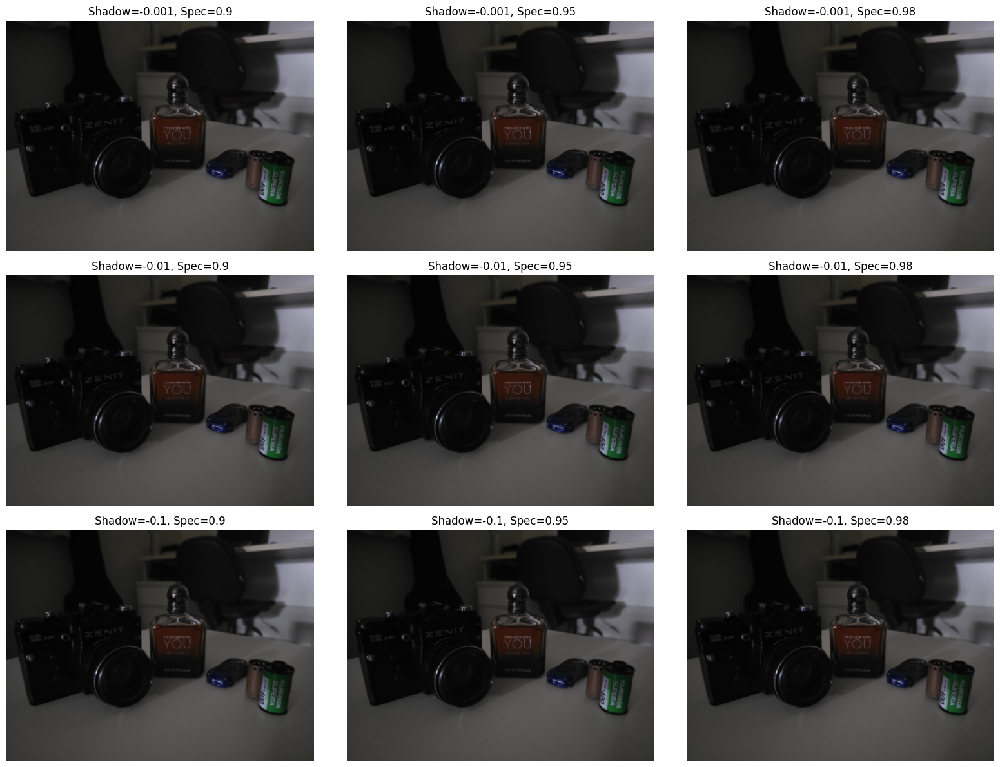

In [193]:
shadow_thresholds = [-0.001, -0.01, -0.1] 

specularity_thresholds = [0.90, 0.95, 0.98] 

fig, axes = plt.subplots(len(shadow_thresholds), len(specularity_thresholds), 
                         figsize=(16, 12))

for i, shadow_threshold in enumerate(shadow_thresholds):
    for j, spec_percentile in enumerate(specularity_thresholds):
        final_image, mask = create_final_image(
            my_detail_transfer,      
            my_piecewise_bilateral,  
            my_flash_image1, 
            my_nonflash_image1,
            shadow_threshold=shadow_threshold,
            spec_percentile=spec_percentile
        )
        
        axes[i, j].imshow(final_image)
        axes[i, j].set_title(f'Shadow={shadow_threshold}, Spec={spec_percentile}')
        axes[i, j].axis('off')

plt.tight_layout()
plt.show()

my_masked_final = create_final_image(
    my_detail_transfer,
    my_piecewise_bilateral,
    my_flash_image1, 
    my_nonflash_image1,
    shadow_threshold=-0.1,
    spec_percentile=0.95
)[0]

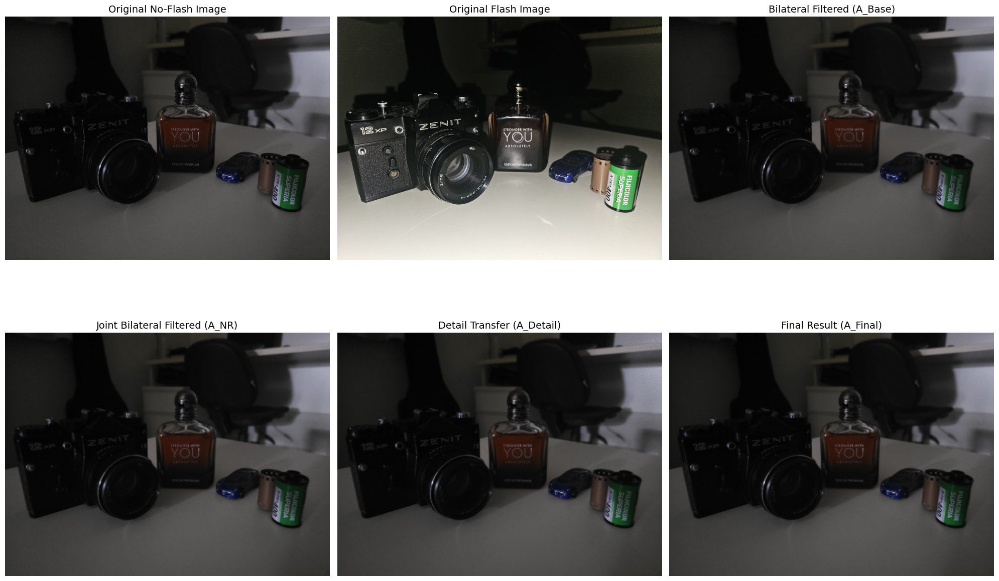

In [201]:
plt.figure(figsize=(20, 14))

plt.subplot(2, 3, 1)
plt.imshow(my_nonflash_image1)
plt.title('Original No-Flash Image', fontsize=14)
plt.axis('off')

plt.subplot(2, 3, 2)
plt.imshow(my_flash_image1)
plt.title('Original Flash Image', fontsize=14)
plt.axis('off')

plt.subplot(2, 3, 3)
plt.imshow(my_piecewise_bilateral)
plt.title('Bilateral Filtered (A_Base)', fontsize=14)
plt.axis('off')

plt.subplot(2, 3, 4)
plt.imshow(my_joint_bilateral)
plt.title('Joint Bilateral Filtered (A_NR)', fontsize=14)
plt.axis('off')

plt.subplot(2, 3, 5)
plt.imshow(my_detail_transfer)
plt.title('Detail Transfer (A_Detail)', fontsize=14)
plt.axis('off')

plt.subplot(2, 3, 6)
plt.imshow(my_masked_final)
plt.title('Final Result (A_Final)', fontsize=14)
plt.axis('off')

plt.tight_layout()
plt.show()

Among them, the original no-flash is superior actually :) Probably because of the some post-processing done by the phone itself. I shot the photos in Pro mode, which should minimize the unwanted post-fx processes but obviously, it wasn't enough.

Iteration 100, Residual: 0.24665518148707558
Iteration 200, Residual: 0.12417805139119664
Iteration 300, Residual: 0.07255301051357212
Iteration 400, Residual: 0.0490548959354427
Iteration 500, Residual: 0.03921762640502308
CGD finished after 500 iterations with residual 0.03921762640502308
Iteration 100, Residual: 0.23580202695829028
Iteration 200, Residual: 0.121544162817184
Iteration 300, Residual: 0.06964733288878287
Iteration 400, Residual: 0.04710503928218523
Iteration 500, Residual: 0.03725074497119394
CGD finished after 500 iterations with residual 0.03725074497119394
Iteration 100, Residual: 0.22924045209038338
Iteration 200, Residual: 0.12008179745599315
Iteration 300, Residual: 0.06814398977305892
Iteration 400, Residual: 0.045831250223601495


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.17378438..0.9505627].


Iteration 500, Residual: 0.03586059468639123
CGD finished after 500 iterations with residual 0.03586059468639123
Iteration 100, Residual: 0.24665518148707558
Iteration 200, Residual: 0.12417805139119664
Iteration 300, Residual: 0.07255301051357212
Iteration 400, Residual: 0.0490548959354427
Iteration 500, Residual: 0.03921762640502308
Iteration 600, Residual: 0.028718739295316823
Iteration 700, Residual: 0.020213855718672326
Iteration 800, Residual: 0.013209752397559204
Iteration 900, Residual: 0.0047329510195259225
Iteration 1000, Residual: 0.002607982518753407
CGD finished after 1000 iterations with residual 0.002607982518753407
Iteration 100, Residual: 0.23580202695829028
Iteration 200, Residual: 0.121544162817184
Iteration 300, Residual: 0.06964733288878287
Iteration 400, Residual: 0.04710503928218523
Iteration 500, Residual: 0.03725074497119394
Iteration 600, Residual: 0.02785281728887082
Iteration 700, Residual: 0.01967502097239125
Iteration 800, Residual: 0.012648426450652171
It

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.10012573..1.0312525].


Iteration 1000, Residual: 0.002482598779517293
CGD finished after 1000 iterations with residual 0.002482598779517293
Iteration 100, Residual: 0.24665518148707558
Iteration 200, Residual: 0.12417805139119664
Iteration 300, Residual: 0.07255301051357212
Iteration 400, Residual: 0.0490548959354427
Iteration 500, Residual: 0.03921762640502308
Iteration 600, Residual: 0.028718739295316823
Iteration 700, Residual: 0.020213855718672326
Iteration 800, Residual: 0.013209752397559204
Iteration 900, Residual: 0.0047329510195259225
Iteration 1000, Residual: 0.002607982518753407
Iteration 1100, Residual: 0.001549609496423629
Iteration 1200, Residual: 0.000746399238862104
Iteration 1300, Residual: 0.00041020162714557734
Iteration 1400, Residual: 0.00030024210994306457
Iteration 1500, Residual: 0.00012259696205616446
Iteration 1600, Residual: 4.9513205105082276e-05
Iteration 1700, Residual: 1.57331644166014e-05
Iteration 1800, Residual: 4.930690440551839e-06
Iteration 1900, Residual: 1.90099138684789

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.09638287..1.0314329].


Iteration 2000, Residual: 5.813718346374744e-07
CGD finished after 2000 iterations with residual 5.813718346374744e-07


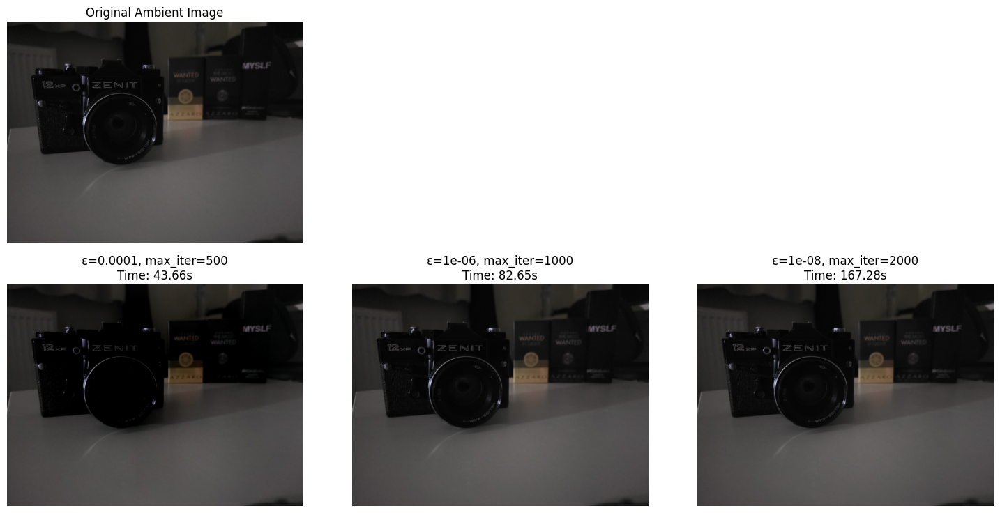

In [195]:
params = [
    (1e-4, 500),  
    (1e-6, 1000), 
    (1e-8, 2000)  
]

plt.figure(figsize=(15, 5*len(params)))

plt.subplot(len(params)+1, 3, 1)
plt.imshow(my_nonflash_image2)
plt.title('Original Ambient Image')
plt.axis('off')

for i, (eps, max_iter) in enumerate(params):
    result, time_taken = experiment_integration(my_nonflash_image2, epsilon=eps, max_iterations=max_iter)
    
    plt.subplot(len(params)+1, 3, i+4)
    plt.imshow(result)
    plt.title(f'ε={eps}, max_iter={max_iter}\nTime: {time_taken:.2f}s')
    plt.axis('off')

plt.tight_layout()
plt.show()

Iteration 100, Residual: 0.2523730107543859
Iteration 200, Residual: 0.1376417540273348
Iteration 300, Residual: 0.05672836063957708
Iteration 400, Residual: 0.03444842357032346
Iteration 500, Residual: 0.02793986158821603
Iteration 600, Residual: 0.022240371261022976
Iteration 700, Residual: 0.015791669328568726
Iteration 800, Residual: 0.010353837171306229
Iteration 900, Residual: 0.0037569877361493865
Iteration 1000, Residual: 0.0023029263617502242
Iteration 1100, Residual: 0.0013322840675162302
Iteration 1200, Residual: 0.0005744995602462383
Iteration 1300, Residual: 0.00022851973392946806
Iteration 1400, Residual: 0.00016330997325089385
Iteration 1500, Residual: 9.869764013674333e-05
Iteration 1600, Residual: 5.012170969845372e-05
Iteration 1700, Residual: 1.486166559476616e-05
Iteration 1800, Residual: 5.196466132944874e-06
Iteration 1900, Residual: 2.224508748727307e-06
Iteration 2000, Residual: 9.935503417925809e-07
CGD finished after 2000 iterations with residual 9.93550341792

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.51317406..1.0991949].


Iteration 2000, Residual: 1.0003966864806468e-06
CGD finished after 2000 iterations with residual 1.0003966864806468e-06
Fusion completed in 163.18 seconds


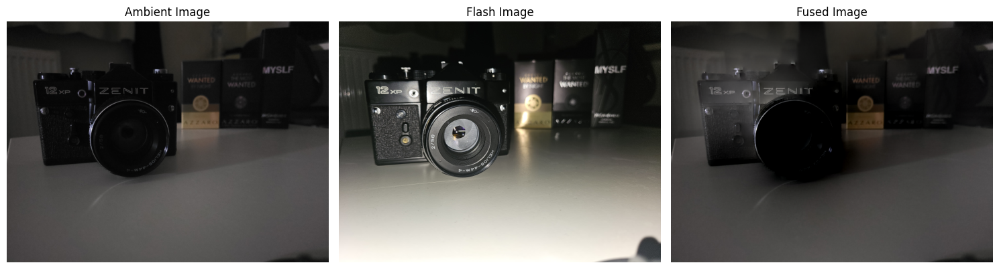

In [196]:
sigma = 10       
tau_s = 0.1      

my_fused_img = create_fused_image(
    my_nonflash_image2, 
    my_flash_image2,    
    sigma=sigma, 
    tau_s=tau_s,
    boundary_type='ambient',
    init_type='zero',
    epsilon=1e-8, 
    max_iterations=2000
)

visualize_gradient_fusion_results(my_nonflash_image2, my_flash_image2, my_fused_img)

Iteration 100, Residual: 0.35925788208785797
Iteration 200, Residual: 0.16362436346118464
Iteration 300, Residual: 0.08052368784706368
Iteration 400, Residual: 0.054924312443296625
Iteration 500, Residual: 0.03442568545052594
Iteration 600, Residual: 0.024091153089295693
Iteration 700, Residual: 0.01923319720703903
Iteration 800, Residual: 0.015975342337701714
Iteration 900, Residual: 0.005646061343331482
Iteration 1000, Residual: 0.003426695430946714
Iteration 1100, Residual: 0.002085088382039385
Iteration 1200, Residual: 0.0008826575704876196
Iteration 1300, Residual: 0.0004835255227706224
Iteration 1400, Residual: 0.00037087873469056993
Iteration 1500, Residual: 0.00016415341125260643
Iteration 1600, Residual: 5.125027461607265e-05
Iteration 1700, Residual: 2.1112927582114597e-05
Iteration 1800, Residual: 5.830759882588978e-06
Iteration 1900, Residual: 2.276215388147484e-06
Iteration 2000, Residual: 9.486019257423447e-07
CGD finished after 2000 iterations with residual 9.48601925742

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.3576076..1.1822704].


Iteration 2000, Residual: 8.767034514166596e-07
CGD finished after 2000 iterations with residual 8.767034514166596e-07
Fusion completed in 158.69 seconds


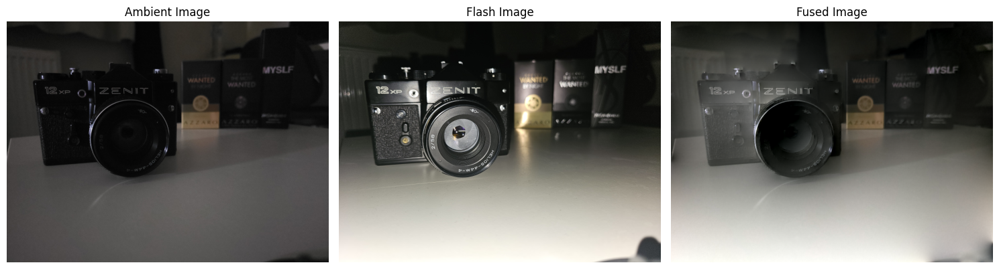

In [197]:
my_fused_img_exp1 = create_fused_image(
    my_nonflash_image2,
    my_flash_image2,
    sigma=sigma, 
    tau_s=tau_s,
    boundary_type='flash',    
    init_type='ambient',      
    epsilon=1e-8, 
    max_iterations=2000
)

visualize_gradient_fusion_results(my_nonflash_image2, my_flash_image2, my_fused_img_exp1)

Iteration 100, Residual: 0.13966686775171955
Iteration 200, Residual: 0.06842483527220644
Iteration 300, Residual: 0.0332381199191899
Iteration 400, Residual: 0.019059110632486418
Iteration 500, Residual: 0.013831693976509936
Iteration 600, Residual: 0.01070999470034164
Iteration 700, Residual: 0.008625112340811892
Iteration 800, Residual: 0.005071771532286807
Iteration 900, Residual: 0.002044757101548156
Iteration 1000, Residual: 0.0012080104716677585
Iteration 1100, Residual: 0.0006625417538188903
Iteration 1200, Residual: 0.0002767544353579108
Iteration 1300, Residual: 0.00012255194094337794
Iteration 1400, Residual: 6.562033544870706e-05
Iteration 1500, Residual: 4.274124934347042e-05
Iteration 1600, Residual: 2.819352584073234e-05
Iteration 1700, Residual: 1.0297016639600754e-05
Iteration 1800, Residual: 3.5474205608626503e-06
Iteration 1900, Residual: 1.5431797916009321e-06
Iteration 2000, Residual: 6.856135906005733e-07
CGD finished after 2000 iterations with residual 6.85613590

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.4353904..1.140733].


Iteration 2000, Residual: 6.323150477908782e-07
CGD finished after 2000 iterations with residual 6.323150477908782e-07
Fusion completed in 159.36 seconds


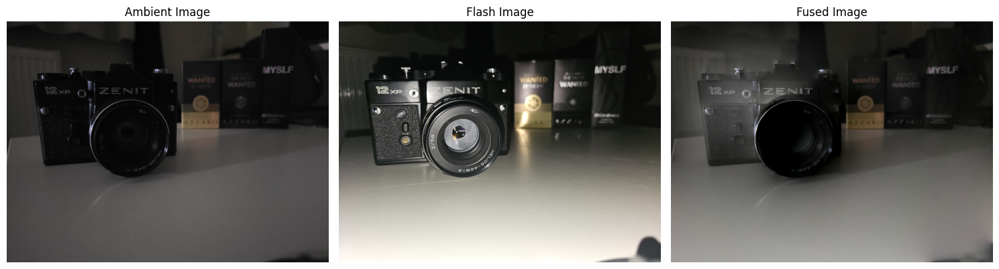

In [198]:
my_fused_img_exp2 = create_fused_image(
    my_nonflash_image2,
    my_flash_image2,
    sigma=sigma, 
    tau_s=tau_s,
    boundary_type='average',  
    init_type='average',      
    epsilon=1e-8, 
    max_iterations=2000
)

visualize_gradient_fusion_results(my_nonflash_image2, my_flash_image2, my_fused_img_exp2)

Iteration 100, Residual: 0.22093474568971955
Iteration 200, Residual: 0.09129174989710456
Iteration 300, Residual: 0.03586442729995897
Iteration 400, Residual: 0.01944132013502024
Iteration 500, Residual: 0.01340955926756086
Iteration 600, Residual: 0.010468852250322616
Iteration 700, Residual: 0.008649612308926155
Iteration 800, Residual: 0.005773156693690825
Iteration 900, Residual: 0.002334646364811226
Iteration 1000, Residual: 0.0010046215355129942
Iteration 1100, Residual: 0.0006500427616248906
Iteration 1200, Residual: 0.0004357010385253705
Iteration 1300, Residual: 0.00021387228632763024
Iteration 1400, Residual: 9.000737919799143e-05
Iteration 1500, Residual: 3.48773615507662e-05
Iteration 1600, Residual: 1.6746630215351807e-05
Iteration 1700, Residual: 1.0449452564331673e-05
Iteration 1800, Residual: 4.4267426473743866e-06
Iteration 1900, Residual: 1.634585914534267e-06
Iteration 2000, Residual: 8.210021200312456e-07
CGD finished after 2000 iterations with residual 8.210021200

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.35760766..1.1822708].


Iteration 2000, Residual: 7.59901261855616e-07
CGD finished after 2000 iterations with residual 7.59901261855616e-07
Fusion completed in 159.78 seconds


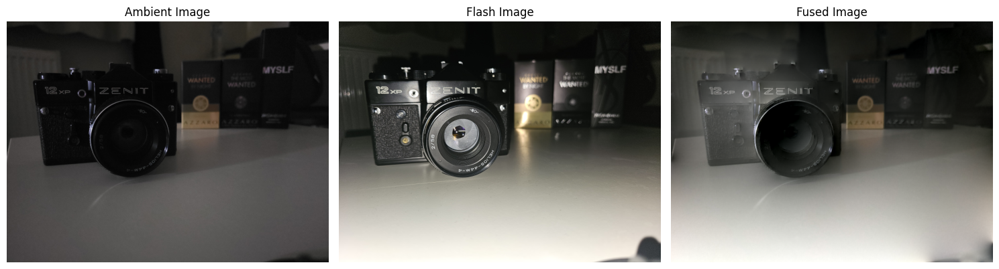

In [199]:
my_fused_img_exp3 = create_fused_image(
    my_nonflash_image2,
    my_flash_image2,
    sigma=sigma, 
    tau_s=tau_s,
    boundary_type='flash',    
    init_type='flash',        
    epsilon=1e-8, 
    max_iterations=2000
)

visualize_gradient_fusion_results(my_nonflash_image2, my_flash_image2, my_fused_img_exp3)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.51317406..1.0991949].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.3576076..1.1822704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.4353904..1.140733].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.35760766..1.1822708].


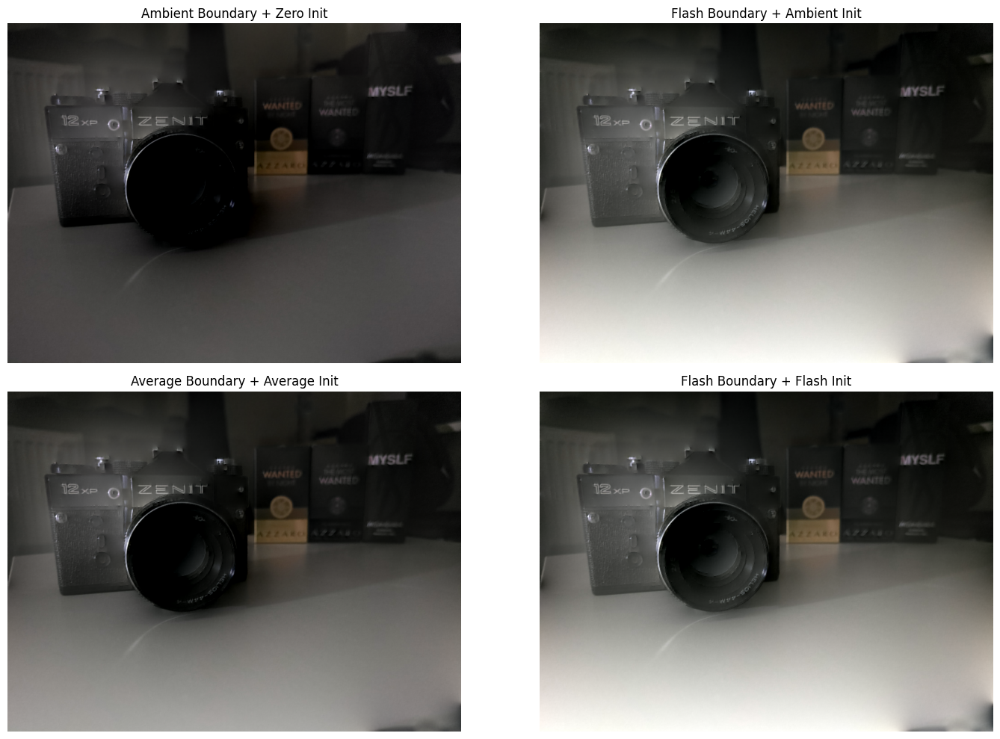

In [200]:
plt.figure(figsize=(15, 10))

plt.subplot(2, 2, 1)
plt.imshow(my_fused_img)
plt.title('Ambient Boundary + Zero Init')
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(my_fused_img_exp1)
plt.title('Flash Boundary + Ambient Init')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(my_fused_img_exp2)
plt.title('Average Boundary + Average Init')
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(my_fused_img_exp3)
plt.title('Flash Boundary + Flash Init')
plt.axis('off')

plt.tight_layout()
plt.show()

Well, it can be clearly seen the results are disasterous. To be frank, I couldn't put much work for this section. I'm already left the submission to one day later than the actual due date, and I don't seem to be able to get more time for this assignment. Maybe my image selection was faulty to begin with, but this was literally the best I could do.